| العمود                                | الوصف                                                                                                  |
| ------------------------------------- | ------------------------------------------------------------------------------------------------------ |
| **Date**                              | تاريخ الحجز (مثال: 3/23/2024).                                                                         |
| **Time**                              | وقت الحجز (مثال: 12:29:38).                                                                            |
| **Booking ID**                        | رقم فريد لكل عملية حجز (لتتبع كل رحلة).                                                                |
| **Booking Status**                    | حالة الحجز (مثال: Completed, Cancelled by Customer, Cancelled by Driver, No Driver Found, Incomplete). |
| **Customer ID**                       | رقم فريد للعميل.                                                                                       |
| **Vehicle Type**                      | نوع المركبة (Go Mini, Go Sedan, Auto, eBike, UberXL, Premier Sedan).                                   |
| **Pickup Location**                   | مكان بداية الرحلة.                                                                                     |
| **Drop Location**                     | مكان نهاية الرحلة.                                                                                     |
| **Avg VTAT**                          | متوسط وقت وصول السائق للعميل (Vehicle Time at Arrival).                                                |
| **Avg CTAT**                          | متوسط وقت انتظار العميل قبل الركوب (Customer Time at Arrival).                                         |
| **Cancelled Rides by Customer**       | هل الرحلة اتلغت من العميل (Yes/No).                                                                    |
| **Reason for cancelling by Customer** | سبب إلغاء العميل (مثال: تأخير السائق).                                                                 |
| **Cancelled Rides by Driver**         | هل الرحلة اتلغت من السائق (Yes/No).                                                                    |
| **Driver Cancellation Reason**        | سبب إلغاء السائق (مثال: مشكلة في السيارة).                                                             |
| **Incomplete Rides**                  | علامة لو الرحلة بدأت وماكملتش.                                                                         |
| **Incomplete Rides Reason**           | سبب عدم إكمال الرحلة.                                                                                  |
| **Booking Value**                     | قيمة الرحلة (الإيراد).                                                                                 |
| **Ride Distance**                     | المسافة المقطوعة (كم).                                                                                 |
| **Driver Ratings**                    | تقييم العميل للسائق (1–5).                                                                             |
| **Customer Rating**                   | تقييم السائق للعميل (1–5).                                                                             |
| **Payment Method**                    | طريقة الدفع (Cash, UPI, Credit Card, Debit Card, Uber Wallet).                                         |

🎯 الهدف (Target Variable)

Target = Booking Value (قيمة الرحلة).

In [80]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import nbformat as nbf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import LabelEncoder
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR

In [81]:
try:
    data = pd.read_csv('Uber Ride Analytics.csv')
except Exception as e:
    print(f"Error loading data: {e}")
    


In [82]:
data.head()

,Date,Time,Booking ID,Booking Status,Customer ID,Vehicle Type,Pickup Location,Drop Location,Avg VTAT,Avg CTAT,...,Reason for cancelling by Customer,Cancelled Rides by Driver,Driver Cancellation Reason,Incomplete Rides,Incomplete Rides Reason,Booking Value,Ride Distance,Driver Ratings,Customer Rating,Payment Method
0,2024-03-23,12:29:38,"""CNR5884300""",No Driver Found,"""CID1982111""",eBike,Palam Vihar,Jhilmil,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2024-11-29,18:01:39,"""CNR1326809""",Incomplete,"""CID4604802""",Go Sedan,Shastri Nagar,Gurgaon Sector 56,4.9,14.0,...,NaN,NaN,NaN,1.0,Vehicle Breakdown,237.0,5.73,NaN,NaN,UPI
2,2024-08-23,08:56:10,"""CNR8494506""",Completed,"""CID9202816""",Auto,Khandsa,Malviya Nagar,13.4,25.8,...,NaN,NaN,NaN,NaN,NaN,627.0,13.58,4.9,4.9,Debit Card
3,2024-10-21,17:17:25,"""CNR8906825""",Completed,"""CID2610914""",Premier Sedan,Central Secretariat,Inderlok,13.1,28.5,...,NaN,NaN,NaN,NaN,NaN,416.0,34.02,4.6,5.0,UPI
4,2024-09-16,22:08:00,"""CNR1950162""",Completed,"""CID9933542""",Bike,Ghitorni Village,Khan Market,5.3,19.6,...,NaN,NaN,NaN,NaN,NaN,737.0,48.21,4.1,4.3,UPI


In [83]:
data.shape

(150000, 21)

In [84]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150000 entries, 0 to 149999
Data columns (total 21 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Date                               150000 non-null  object 
 1   Time                               150000 non-null  object 
 2   Booking ID                         150000 non-null  object 
 3   Booking Status                     150000 non-null  object 
 4   Customer ID                        150000 non-null  object 
 5   Vehicle Type                       150000 non-null  object 
 6   Pickup Location                    150000 non-null  object 
 7   Drop Location                      150000 non-null  object 
 8   Avg VTAT                           139500 non-null  float64
 9   Avg CTAT                           102000 non-null  float64
 10  Cancelled Rides by Customer        10500 non-null   float64
 11  Reason for cancelling by Customer  1050

In [85]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
Avg VTAT,139500.0,8.456352,3.773564,2.0,5.30,8.30,11.30,20.0
Avg CTAT,102000.0,29.149636,8.902577,10.0,21.60,28.80,36.80,45.0
Cancelled Rides by Customer,10500.0,1.000000,0.000000,1.0,1.00,1.00,1.00,1.0
Cancelled Rides by Driver,27000.0,1.000000,0.000000,1.0,1.00,1.00,1.00,1.0
Incomplete Rides,9000.0,1.000000,0.000000,1.0,1.00,1.00,1.00,1.0
Booking Value,102000.0,508.295912,395.805774,50.0,234.00,414.00,689.00,4277.0
Ride Distance,102000.0,24.637012,14.002138,1.0,12.46,23.72,36.82,50.0
Driver Ratings,93000.0,4.230992,0.436871,3.0,4.10,4.30,4.60,5.0
Customer Rating,93000.0,4.404584,0.437819,3.0,4.20,4.50,4.80,5.0


In [86]:
print("Missing values in each column:")
data.isnull().sum()

Missing values in each column:


Date                                      0
Time                                      0
Booking ID                                0
Booking Status                            0
Customer ID                               0
Vehicle Type                              0
Pickup Location                           0
Drop Location                             0
Avg VTAT                              10500
Avg CTAT                              48000
Cancelled Rides by Customer          139500
Reason for cancelling by Customer    139500
Cancelled Rides by Driver            123000
Driver Cancellation Reason           123000
Incomplete Rides                     141000
Incomplete Rides Reason              141000
Booking Value                         48000
Ride Distance                         48000
Driver Ratings                        57000
Customer Rating                       57000
Payment Method                        48000
dtype: int64

In [87]:
# -----------------------------
# 1️⃣ حذف الصفوف اللي ناقص فيها الـ Target (Booking Value)
# -----------------------------
data = data.dropna(subset=["Booking Value"])

# -----------------------------
# 2️⃣ تعويض القيم العددية (بالـ Median)
# -----------------------------
numeric_cols = ["Avg VTAT", "Avg CTAT", "Ride Distance", "Driver Ratings", "Customer Rating"]

for col in numeric_cols:
    median_val = data[col].median()
    data[col].fillna(median_val, inplace=True)

# -----------------------------
# 3️⃣ تعويض القيم الفئوية (Yes/No → No)
# -----------------------------
flag_cols = ["Cancelled Rides by Customer", "Cancelled Rides by Driver", "Incomplete Rides"]

for col in flag_cols:
    data[col].fillna("No", inplace=True)

# -----------------------------
# 4️⃣ تعويض الأعمدة النصية الخاصة بالأسباب
# -----------------------------
reason_cols = ["Reason for cancelling by Customer", "Driver Cancellation Reason", "Incomplete Rides Reason"]

for col in reason_cols:
    data[col].fillna("Not Applicable", inplace=True)

# -----------------------------
# 5️⃣ تعويض الأعمدة الفئوية الأخرى
# -----------------------------
# Payment Method → Unknown
data["Payment Method"].fillna("Unknown", inplace=True)

# -----------------------------
# ✅ بعد المعالجة
# -----------------------------
print("Missing values after cleaning:")
print(data.isnull().sum())

Missing values after cleaning:
Date                                 0
Time                                 0
Booking ID                           0
Booking Status                       0
Customer ID                          0
Vehicle Type                         0
Pickup Location                      0
Drop Location                        0
Avg VTAT                             0
Avg CTAT                             0
Cancelled Rides by Customer          0
Reason for cancelling by Customer    0
Cancelled Rides by Driver            0
Driver Cancellation Reason           0
Incomplete Rides                     0
Incomplete Rides Reason              0
Booking Value                        0
Ride Distance                        0
Driver Ratings                       0
Customer Rating                      0
Payment Method                       0
dtype: int64


C:\Users\SABRY\AppData\Local\Temp\ipykernel_22704\4179173741.py:13: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



C:\Users\SABRY\AppData\Local\Temp\ipykernel_22704\4179173741.py:21: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplac

In [88]:
# data.to_csv("cleaned_data.csv",index=False)

In [89]:
data['Incomplete Rides'] = data['Incomplete Rides'].replace(1 , 'yes')

In [90]:
data['Incomplete Rides']

1         yes
2          No
3          No
4          No
5          No
         ... 
149995     No
149996     No
149997     No
149998     No
149999     No
Name: Incomplete Rides, Length: 102000, dtype: object

In [91]:
NUM_COL = data.select_dtypes(include=['number']).columns
CAT_COL = data.select_dtypes(include=['object']).columns
print(f"The number of numerical columns are {len(NUM_COL)}")
print(f"The number of categorical columns are {len(CAT_COL)}")


The number of numerical columns are 6
The number of categorical columns are 15


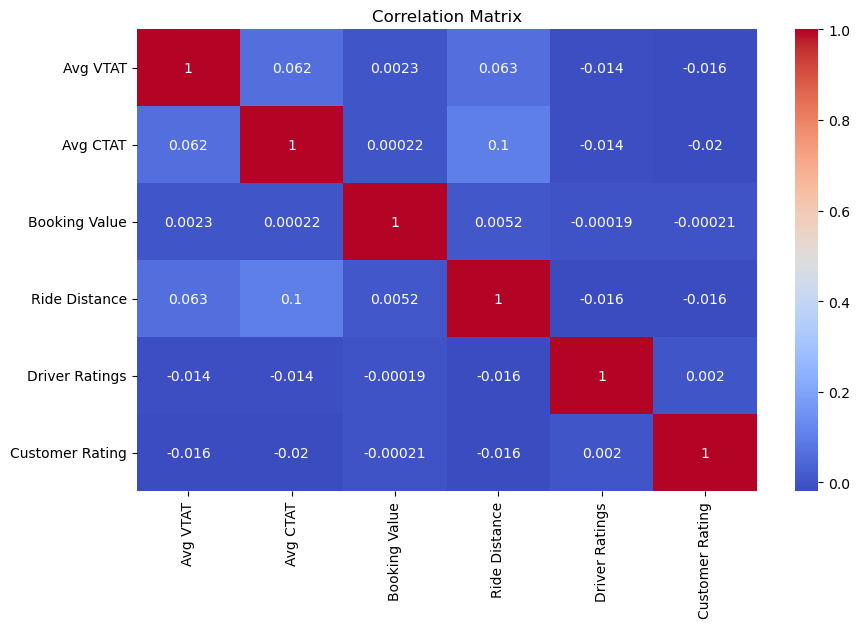

In [92]:
plt.figure(figsize=(10,6))
sns.heatmap(data[NUM_COL].corr(), annot=True, cmap="coolwarm")
plt.title("Correlation Matrix")
plt.show()

In [93]:
data['Date'] = pd.to_datetime(data['Date'])


In [94]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 102000 entries, 1 to 149999
Data columns (total 21 columns):
 #   Column                             Non-Null Count   Dtype         
---  ------                             --------------   -----         
 0   Date                               102000 non-null  datetime64[ns]
 1   Time                               102000 non-null  object        
 2   Booking ID                         102000 non-null  object        
 3   Booking Status                     102000 non-null  object        
 4   Customer ID                        102000 non-null  object        
 5   Vehicle Type                       102000 non-null  object        
 6   Pickup Location                    102000 non-null  object        
 7   Drop Location                      102000 non-null  object        
 8   Avg VTAT                           102000 non-null  float64       
 9   Avg CTAT                           102000 non-null  float64       
 10  Cancelled Rides by Custom

In [95]:
data['Hour'] = pd.to_datetime(data['Time'], format='%H:%M:%S').dt.hour


In [96]:
data['Time_Period'] = pd.cut(data['Hour'], 
                          bins=[0, 6, 12, 18, 24], 
                          labels=['Night', 'Morning', 'Afternoon', 'Evening'])

In [97]:
#حساب Revenue_per_KM
data['Revenue_per_KM'] = data['Booking Value'] / data['Ride Distance'].replace(0, np.nan)

In [98]:
#تصنيف الرحلات حسب القيمة
data['Revenue_Category'] = pd.cut(data['Booking Value'], 
                               bins=[0, 50, 100, 200, float('inf')], 
                               labels=['Low', 'Medium', 'High', 'Premium'])

In [99]:
data['Total_Wait_Time'] = data['Avg VTAT'] + data['Avg CTAT']

In [100]:
data['Wait_Time_Category'] = pd.cut(data['Total_Wait_Time'], 
                                 bins=[0, 5, 10, 15, float('inf')], 
                                 labels=['Fast', 'Normal', 'Slow', 'Very Slow'])

In [101]:
data.head()

,Date,Time,Booking ID,Booking Status,Customer ID,Vehicle Type,Pickup Location,Drop Location,Avg VTAT,Avg CTAT,...,Ride Distance,Driver Ratings,Customer Rating,Payment Method,Hour,Time_Period,Revenue_per_KM,Revenue_Category,Total_Wait_Time,Wait_Time_Category
1,2024-11-29,18:01:39,"""CNR1326809""",Incomplete,"""CID4604802""",Go Sedan,Shastri Nagar,Gurgaon Sector 56,4.9,14.0,...,5.73,4.3,4.5,UPI,18,Afternoon,41.361257,Premium,18.9,Very Slow
2,2024-08-23,08:56:10,"""CNR8494506""",Completed,"""CID9202816""",Auto,Khandsa,Malviya Nagar,13.4,25.8,...,13.58,4.9,4.9,Debit Card,8,Morning,46.170839,Premium,39.2,Very Slow
3,2024-10-21,17:17:25,"""CNR8906825""",Completed,"""CID2610914""",Premier Sedan,Central Secretariat,Inderlok,13.1,28.5,...,34.02,4.6,5.0,UPI,17,Afternoon,12.228101,Premium,41.6,Very Slow
4,2024-09-16,22:08:00,"""CNR1950162""",Completed,"""CID9933542""",Bike,Ghitorni Village,Khan Market,5.3,19.6,...,48.21,4.1,4.3,UPI,22,Evening,15.287285,Premium,24.9,Very Slow
5,2024-02-06,09:44:56,"""CNR4096693""",Completed,"""CID4670564""",Auto,AIIMS,Narsinghpur,5.1,18.1,...,4.85,4.1,4.6,UPI,9,Morning,65.154639,Premium,23.2,Very Slow


## Columns -> Date 📅


In [102]:
# نعد عدد الحجوزات أو الصفوف لكل يوم
daily_counts = data.groupby('Date').size().reset_index(name='Count')

fig = px.line(daily_counts, 
              x='Date', 
              y='Count', 
              title='Number of Bookings over Time')
fig.show()

## Columns -> Booking Status 📊


In [103]:
data['Booking Status'].value_counts()

Booking Status
Completed     93000
Incomplete     9000
Name: count, dtype: int64

In [105]:
FIG = px.histogram(
    data,
    x='Booking Status',
    title='Booking Status Distribution',
    color='Booking Status'

)
FIG.show()

In [109]:
FIG = px.pie(
    data,
    names='Booking Status',
    title='Booking Status Distribution',
    color='Booking Status',
    color_discrete_sequence=["#857673", '#4682B4']

)
FIG.show()


In [120]:
avg_booking = data.groupby('Booking Status')['Booking Value'].mean().reset_index()
FIG = px.bar(avg_booking,
            x='Booking Status',
            y='Booking Value',
            title='Average Booking Value by Status',
            color='Booking Status')
FIG.update_layout(xaxis_tickangle=-45)
FIG.show()

In [129]:
FIG = px.histogram(data, x='Booking Value', color='Booking Status',
                    title='Distribution of Booking Values by Status',
                    nbins=30)
FIG.show()

In [121]:
FIG = px.sunburst(data, 
                   path=['Booking Status', 'Revenue_Category'], 
                   values='Booking Value',
                   title='Distribution of Booking Values by Status and Revenue Category'
                   )

FIG.show()

## Columns -> Vehicle Type 🚗

In [122]:
data['Vehicle Type'].value_counts()

Vehicle Type
Auto             25415
Go Mini          20364
Go Sedan         18318
Bike             15362
Premier Sedan    12315
eBike             7181
Uber XL           3045
Name: count, dtype: int64

In [ ]:
FIG = px.histogram(
    data,
    x='Vehicle Type',
    title='Distribution of Vehicle Types by Status',
    color='Vehicle Type',
    nbins=30,

)
FIG.show()

In [131]:
FIG = px.histogram(data, x='Vehicle Type',
                    color='Booking Status',
                    title='Distribution of Vehicle Types by Status',
                    nbins=30,
                    color_discrete_sequence = ["#857673", '#4682B4']
                   )
FIG.show()

In [133]:
avg_prices = data.groupby('Vehicle Type')['Booking Value'].agg(['mean', 'median', 'count']).reset_index()
fig2 = px.bar(avg_prices, x='Vehicle Type', y='mean',
              title='Distribution of Vehicle Types by Booking Value',
              color='Vehicle Type',
              text='mean')
fig2.update_traces(texttemplate='%{text:.0f}', textposition='outside')
fig2.update_layout(xaxis_tickangle=-45, height=500)
fig2.show()

In [136]:
fig4 = px.histogram(data, x='Booking Value', color='Vehicle Type',
                    title='Distribution of Booking Values by Vehicle Type',
                    nbins=30,
                    marginal="box")
fig4.show()

## columns ->  Pickup Location

In [143]:
data['Pickup Location'].unique()

array(['Shastri Nagar', 'Khandsa', 'Central Secretariat',
       'Ghitorni Village', 'AIIMS', 'Vaishali', 'Mayur Vihar', 'Rohini',
       'Udyog Bhawan', 'Malviya Nagar', 'Madipur', 'Jama Masjid',
       'IGI Airport', 'Punjabi Bagh', 'Greater Noida', 'Tis Hazari',
       'Noida Sector 18', 'Kanhaiya Nagar', 'Okhla', 'Shastri Park',
       'Faridabad Sector 15', 'Mundka', 'DLF City Court', 'Nirman Vihar',
       'New Delhi Railway Station', 'Civil Lines Gurgaon', 'Seelampur',
       'Vinobapuri', 'Panipat', 'Sultanpur', 'Dilshad Garden',
       'Aya Nagar', 'Rajiv Chowk', 'MG Road', 'Jasola', 'Kashmere Gate',
       'Tughlakabad', 'Cyber Hub', 'Vidhan Sabha', 'Anand Vihar',
       'Uttam Nagar', 'Model Town', 'Ghitorni', 'Rajiv Nagar',
       'Sohna Road', 'Lajpat Nagar', 'Moolchand', 'INA Market',
       'IIT Delhi', 'Satguru Ram Singh Marg', 'Munirka', 'New Colony',
       'IGNOU Road', 'Meerut', 'Akshardham', 'IMT Manesar', 'Azadpur',
       'Sikanderpur', 'Rohini West', 'Mandi Hous

In [140]:
## مواقع الانطلاق الأكثر شيوعاً
pickup_counts = data['Pickup Location'].value_counts().head(15)
fig1 = px.bar(x=pickup_counts.index,
              y=pickup_counts.values,
              title='Most Common Pickup Locations',
              labels={'x': 'Pickup Location', 'y': 'Number of Trips'},
              color=pickup_counts.values,
              color_continuous_scale='viridis')
fig1.update_layout(xaxis_tickangle=-45, height=500)
fig1.show()

In [146]:
FIG = px.histogram(
    data,
    x = 'Pickup Location',
    y = 'Booking Value',
    title = 'Distribution of Uber Bookings by Pickup Location',
    color = 'Pickup Location',
)
FIG.show()

## columns ->  Drop Location

In [ ]:
# Most Common Drop Locations
drop_counts = data['Drop Location'].value_counts().head(15)
fig2 = px.bar(x=drop_counts.index,
              y=drop_counts.values,
              title='Most Common Drop Locations',
              labels={'x': 'Drop Location', 'y': 'Number of Trips'},
              color=drop_counts.values,
              color_continuous_scale='plasma')
fig2.update_layout(xaxis_tickangle=-45, height=500)


In [ ]:
FIG = px.histogram(
    data,
    x = 'Drop Location',
    y = 'Booking Value',
    title = 'Distribution of Uber Bookings by Drop Location',
    color = 'Drop Location',
)
FIG.show()